<a href="https://colab.research.google.com/github/Iqra456/Covid-19-Data-Analysis-and-Prediction/blob/main/Covid_19.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import pandas as pd
import numpy as np
import plotly
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly import graph_objects as go
import fbprophet
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
from fbprophet import Prophet 

In [ ]:
df=pd.read_csv("/content/covid_19_india (2).csv",index_col=0)

In [ ]:
df

,Date,Time,State/UnionTerritory,Cured,Deaths,Confirmed
Sno,,,,,,
1,30-01-2020,6:00 PM,Kerala,0,0,1
2,31-01-2020,6:00 PM,Kerala,0,0,1
3,01-02-2020,6:00 PM,Kerala,0,0,2
4,02-02-2020,6:00 PM,Kerala,0,0,3
5,03-02-2020,6:00 PM,Kerala,0,0,3
...,...,...,...,...,...,...
16378,24-06-2021,8:00 AM,Telangana,596628,3598,616688
16379,24-06-2021,8:00 AM,Tripura,58978,660,63499
16380,24-06-2021,8:00 AM,Uttarakhand,329182,7068,339127


In [ ]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16382 entries, 1 to 16382
Data columns (total 6 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   Date                  16382 non-null  object
 1   Time                  16382 non-null  object
 2   State/UnionTerritory  16382 non-null  object
 3   Cured                 16382 non-null  int64 
 4   Deaths                16382 non-null  int64 
 5   Confirmed             16382 non-null  int64 
dtypes: int64(3), object(3)
memory usage: 895.9+ KB
None


In [ ]:
df.isnull().sum()

Date                    0
Time                    0
State/UnionTerritory    0
Cured                   0
Deaths                  0
Confirmed               0
dtype: int64

In [ ]:
total_cases=df["Confirmed"].sum()
print("Total number of confirmed COVID 19 cases across the India till date (24th June 2021): ",total_cases)

Total number of confirmed COVID 19 cases across the India till date (24th June 2021):  3958181721


In [ ]:
df.insert(5,"Active Cases"," ")

In [ ]:
df["Active Cases"]=df["Confirmed"] - df["Deaths"] - df["Cured"]
total_cases=df["Active Cases"].sum()
print("Total number of active cases COVID 19 cases across the India till date (24th June 2021): ",total_cases)
df.style.background_gradient(cmap="Reds")

Total number of active cases COVID 19 cases across the India till date (24th June 2021):  310680260


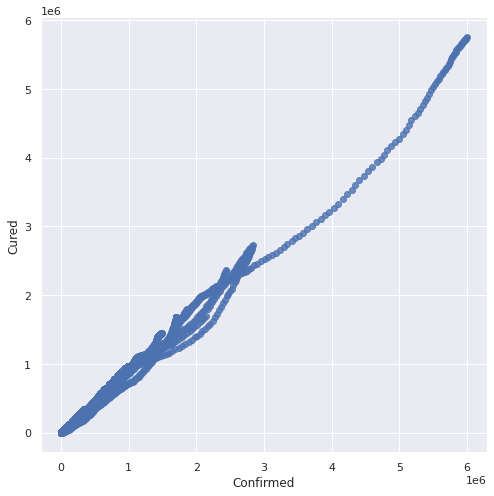

In [ ]:
fig_dims=(8,8)
fig,ax=plt.subplots(figsize=fig_dims)
sns.set(style="darkgrid")
sns.regplot(x="Confirmed", y="Cured",data=df,fit_reg=False)

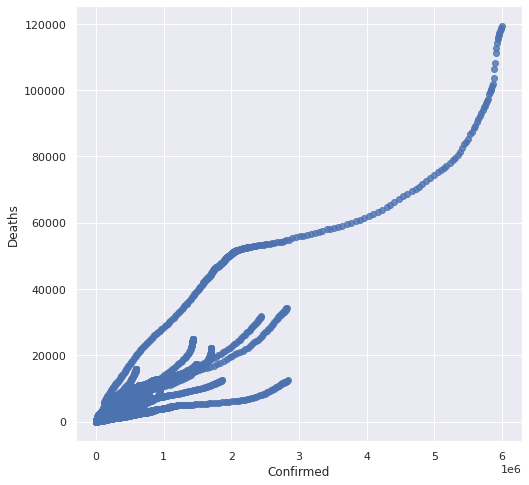

In [ ]:
fig_dims=(8,8)
fig,ax=plt.subplots(figsize=fig_dims)
sns.set(style="darkgrid")
sns.regplot(x="Confirmed", y="Deaths", data=df, fit_reg=False)

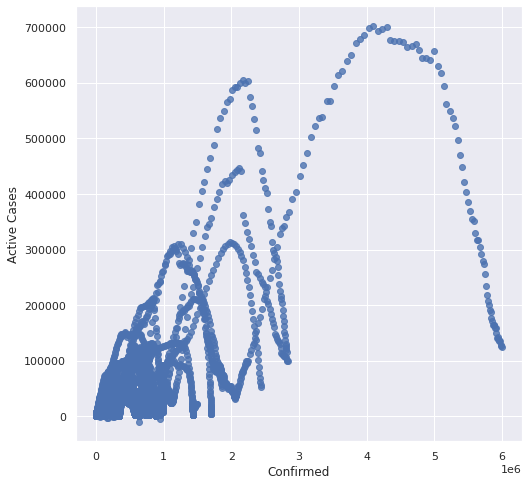

In [ ]:
fig_dims=(8,8)
fig,ax=plt.subplots(figsize=fig_dims)
sns.set(style="darkgrid")
sns.regplot(x="Confirmed", y="Active Cases",data=df,fit_reg=False)

<Figure size 1440x1440 with 0 Axes>

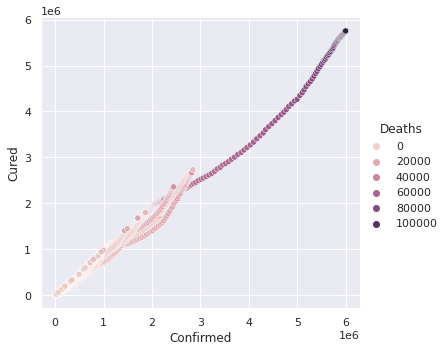

In [ ]:
plt.figure(figsize=(20,20))
sns.set(style="darkgrid")
sns.relplot(x="Confirmed", y="Cured",hue="Deaths",data=df)

In [ ]:
fig=go.Figure()
fig.add_trace(go.Scatter(x=df["Date"],y=df["Confirmed"],mode="lines+markers",name="Confirmed"))
fig.update_layout(title_text="Trend of coronavirus In India",plot_bgcolor="rgb(230,230,230)")
fig.show()

In [ ]:
fig=px.bar(df,x="Date",y="Confirmed",barmode="group",height=400)
fig.update_layout(title_text="COVID CASES IN INDIA",plot_bgcolor="rgb(230,230,230)")
fig.show()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Text(0.5, 1.0, 'Bar Plot of COVID 19 Cases Statewise')

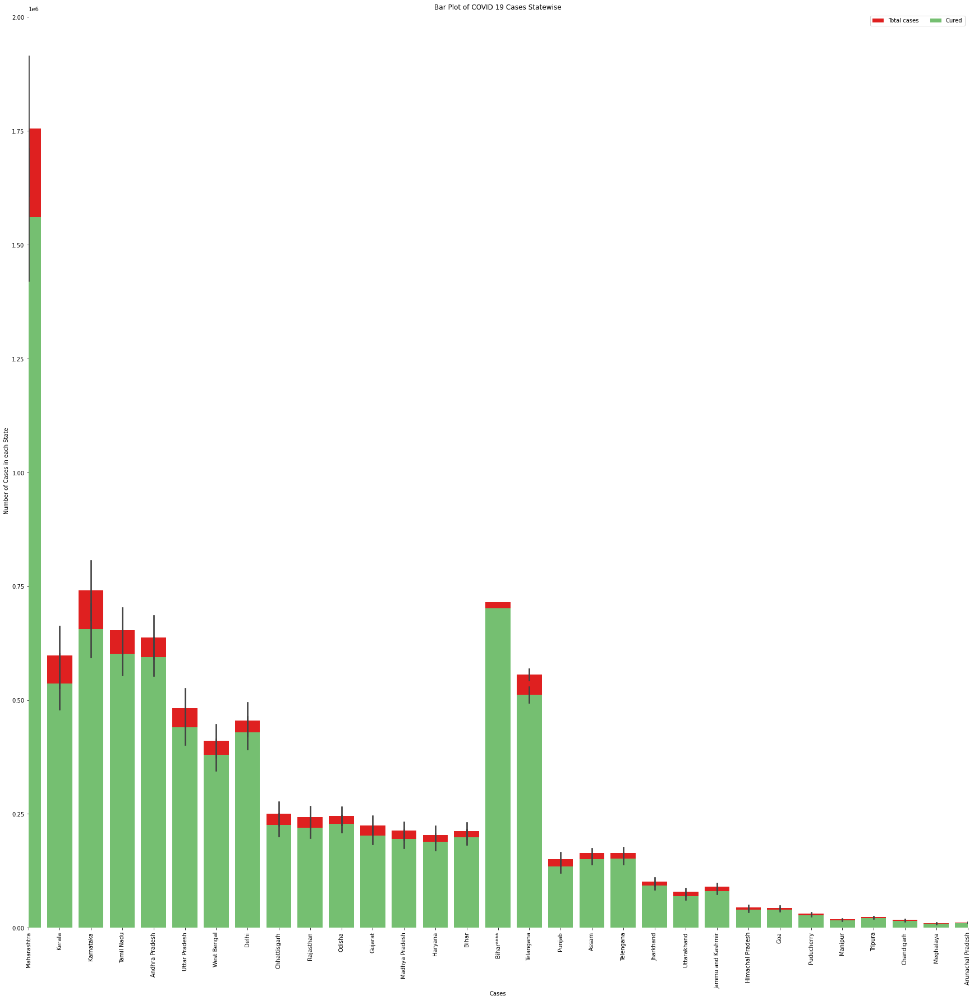

In [ ]:
fig,ax= plt.subplots(figsize=(30,30))
data = df[["State/UnionTerritory","Confirmed","Cured","Deaths"]]
data.sort_values("Confirmed",ascending=False,inplace=True)
#sns.set_color_codes("pastel")
sns.barplot(x="State/UnionTerritory",y="Confirmed",data=data,label="Total cases",color="r")

sns.set_color_codes("muted")
sns.barplot(x="State/UnionTerritory",y="Cured",data=data,label="Cured",color="g")

ax.legend(ncol=2,loc="upper right",frameon=True)
ax.set(xlim=(0,30),ylabel="Number of Cases in each State",xlabel="Cases")
sns.despine(left=True,bottom=True)
plt.xticks(rotation=90)
plt.title("Bar Plot of COVID 19 Cases Statewise")











In [ ]:
df_datewise=df.groupby(['Date'], sort = False).sum().reset_index()


In [ ]:
df_datewise.style.background_gradient(cmap="Reds")

,Date,Cured,Deaths,Active Cases,Confirmed
0,30-01-2020,0,0,1,1
1,31-01-2020,0,0,1,1
2,01-02-2020,0,0,2,2
3,02-02-2020,0,0,3,3
4,03-02-2020,0,0,3,3
5,04-02-2020,0,0,3,3
6,05-02-2020,0,0,3,3
7,06-02-2020,0,0,3,3
8,07-02-2020,0,0,3,3
9,08-02-2020,0,0,3,3


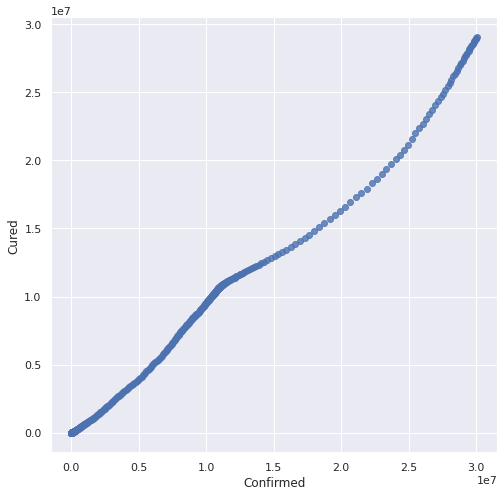

In [ ]:
fig_dims=(8,8)
fig,ax=plt.subplots(figsize=fig_dims)
sns.set(style="darkgrid")
sns.regplot(x="Confirmed", y="Cured",data=df_datewise,fit_reg=False)

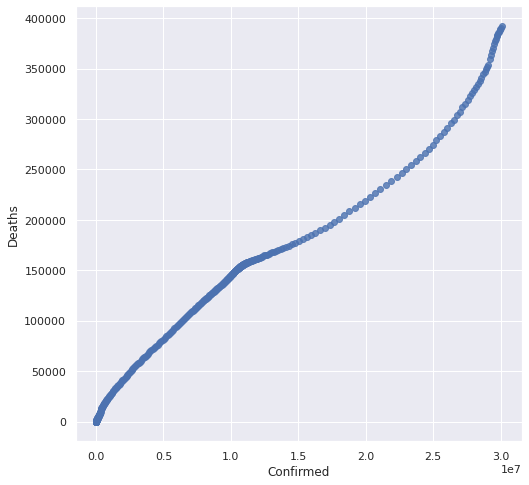

In [ ]:
fig_dims=(8,8)
fig,ax=plt.subplots(figsize=fig_dims)
sns.set(style="darkgrid")
sns.regplot(x="Confirmed", y="Deaths",data=df_datewise,fit_reg=False)

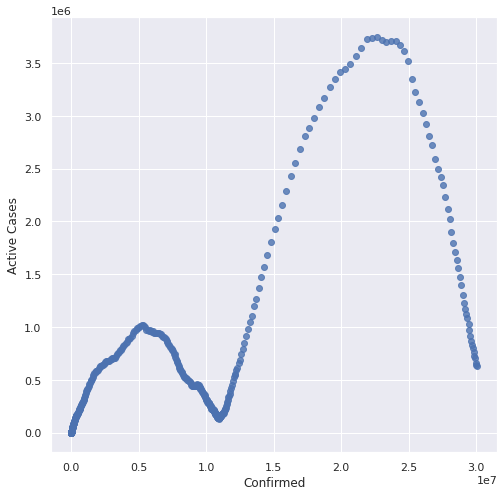

In [ ]:
fig_dims=(8,8)
fig,ax=plt.subplots(figsize=fig_dims)
sns.set(style="darkgrid")
sns.regplot(x="Confirmed", y="Active Cases",data=df_datewise,fit_reg=False)

<Figure size 1440x1440 with 0 Axes>

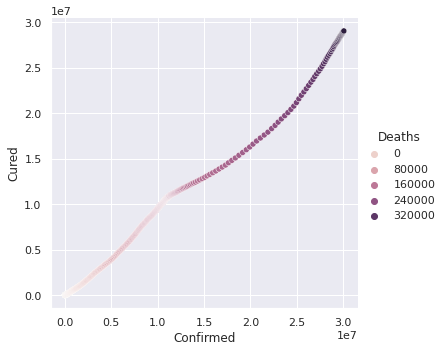

In [ ]:
plt.figure(figsize=(20,20))
sns.set(style="darkgrid")
sns.relplot(x="Confirmed", y="Cured",hue="Deaths",data=df_datewise)

In [ ]:
fig=px.bar(df_datewise,x=df_datewise["Date"],y=df_datewise["Confirmed"],color="Confirmed",height=600,
           title="Total Cases In India")
fig.show()

In [ ]:
fig = plt.figure(figsize = (12, 12))
figure=go.Figure()
figure.add_trace(go.Scatter(x=df_datewise['Date'],y=df_datewise['Confirmed'],mode='lines+markers',name='Confirmed',line=dict(color="Blue")))
figure.add_trace(go.Scatter(x=df_datewise['Date'],y=df_datewise["Active Cases"], mode='lines+markers',name='Active',line=dict(color="Yellow")))
figure.add_trace(go.Scatter(x=df_datewise['Date'],y=df_datewise["Deaths"], mode='lines+markers',name='Deaths',line=dict(color="Red")))
figure.add_trace(go.Scatter(x=df_datewise['Date'],y=df_datewise["Cured"], mode='lines+markers',name='Cured',line=dict(color="Green")))
figure.update_layout(title="COVID 19 Cases In India",xaxis_tickfont_size=14,yaxis=dict(title="Number of cases"))
figure.show()

<Figure size 864x864 with 0 Axes>

In [ ]:
confirmed=df_datewise.groupby(['Date'], sort = False)['Confirmed'].sum().reset_index()
deaths=df_datewise.groupby(['Date'], sort = False)['Deaths'].sum().reset_index()
cured=df_datewise.groupby(['Date'], sort = False)['Cured'].sum().reset_index()

In [ ]:
confirmed.tail()

,Date,Confirmed
507,20-06-2021,29881965
508,21-06-2021,29935221
509,22-06-2021,29977861
510,23-06-2021,30028709
511,24-06-2021,30082778


In [ ]:
confirmed.columns=['ds','y']
#confirmed["ds"]=pd.to_datetime(confirmed["ds"])
#confirmed["ds"]=confirmed["ds"].dt.date 
confirmed["ds"]=pd.to_datetime(confirmed['ds'],dayfirst=True, yearfirst=True)

In [ ]:
confirmed.tail()

,ds,y
507,2021-06-20,29881965
508,2021-06-21,29935221
509,2021-06-22,29977861
510,2021-06-23,30028709
511,2021-06-24,30082778


In [ ]:
model=Prophet(interval_width=0.95)
model.fit(confirmed)
future=model.make_future_dataframe(periods=20)
future.tail()

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds
527,2021-07-10
528,2021-07-11
529,2021-07-12
530,2021-07-13
531,2021-07-14


In [ ]:
prediction=model.predict(future)
prediction[['ds','yhat','yhat_lower','yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
527,2021-07-10,3.500228e+07,3.365413e+07,3.633152e+07
528,2021-07-11,3.521263e+07,3.369996e+07,3.658621e+07
529,2021-07-12,3.542037e+07,3.404558e+07,3.686936e+07
530,2021-07-13,3.562262e+07,3.420934e+07,3.710932e+07
531,2021-07-14,3.583039e+07,3.430926e+07,3.735189e+07


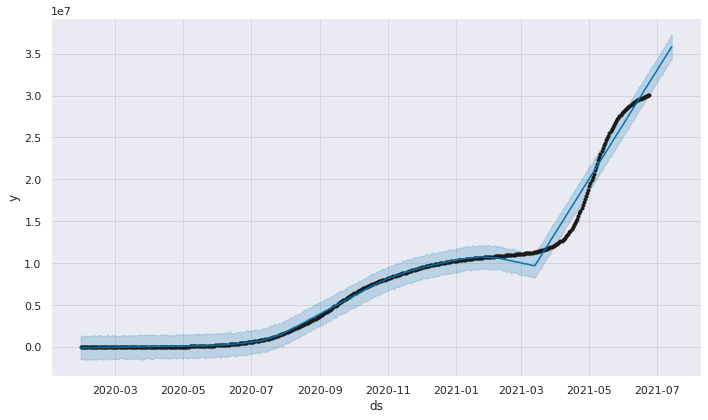

In [ ]:
confirmed_plot=model.plot(prediction)

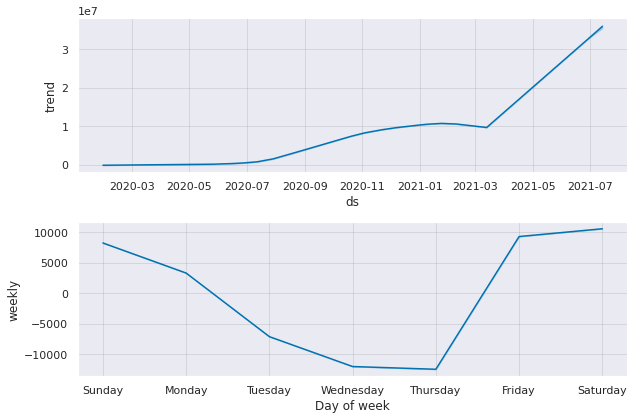

In [ ]:
confirmed_plot2=model.plot_components(prediction)

In [ ]:
deaths.columns=['ds','y'] 
deaths["ds"]=pd.to_datetime(deaths['ds'], dayfirst=True, yearfirst=True)

In [ ]:
deaths.tail()

,ds,y
507,2021-06-20,386713
508,2021-06-21,388135
509,2021-06-22,389302
510,2021-06-23,390660
511,2021-06-24,391981


In [ ]:
model=Prophet(interval_width=0.95)
model.fit(deaths)
future=model.make_future_dataframe(periods=20)
future.tail()

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds
527,2021-07-10
528,2021-07-11
529,2021-07-12
530,2021-07-13
531,2021-07-14


In [ ]:
prediction=model.predict(future)
prediction[['ds','yhat','yhat_lower','yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
527,2021-07-10,407284.347057,385170.637905,428971.035743
528,2021-07-11,409620.875414,386905.428720,432419.384341
529,2021-07-12,411944.060715,388289.276889,434342.299473
530,2021-07-13,414226.523406,390392.225013,435292.360658
531,2021-07-14,416609.016548,392568.147474,438921.176999


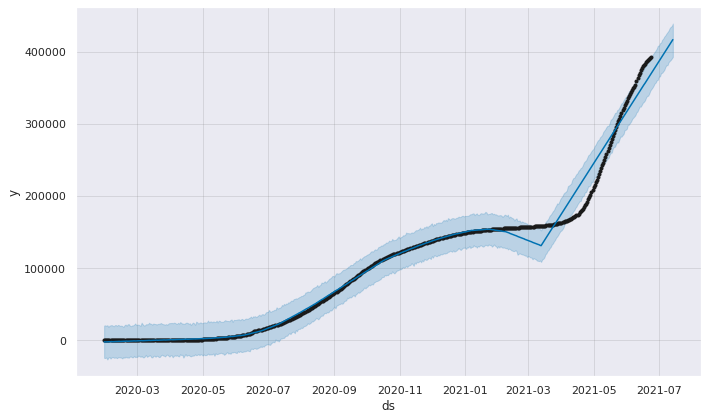

In [ ]:
Deaths_plot=model.plot(prediction)

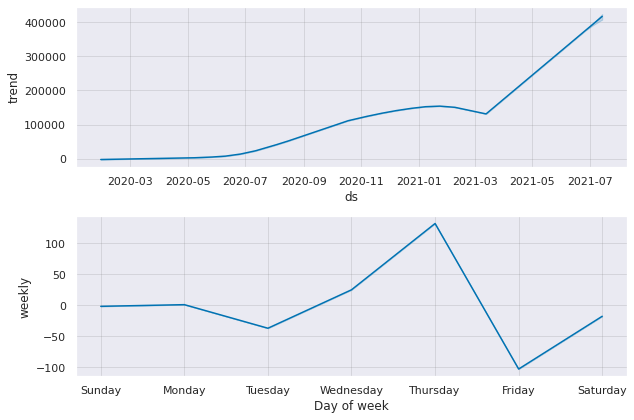

In [ ]:
Deaths_plot2=model.plot_components(prediction)

In [ ]:
cured.columns=['ds','y'] 
cured["ds"]=pd.to_datetime(cured['ds'], dayfirst=True, yearfirst=True)

In [ ]:
cured.tail()

,ds,y
507,2021-06-20,28766009
508,2021-06-21,28844199
509,2021-06-22,28926038
510,2021-06-23,28994855
511,2021-06-24,29063740


In [ ]:
model=Prophet(interval_width=0.95)
model.fit(cured)
future=model.make_future_dataframe(periods=20)
future.tail()

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds
527,2021-07-10
528,2021-07-11
529,2021-07-12
530,2021-07-13
531,2021-07-14


In [ ]:
prediction.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2020-01-30,-2245.178406,-24401.369067,20444.329882,-2245.178406,-2245.178406,132.102700,132.102700,132.102700,132.102700,132.102700,132.102700,0.0,0.0,0.0,-2113.075706
1,2020-01-31,-2196.788486,-24517.009411,20763.518028,-2196.788486,-2196.788486,-102.631757,-102.631757,-102.631757,-102.631757,-102.631757,-102.631757,0.0,0.0,0.0,-2299.420243
2,2020-02-01,-2148.398567,-23789.464112,20021.191208,-2148.398567,-2148.398567,-17.524002,-17.524002,-17.524002,-17.524002,-17.524002,-17.524002,0.0,0.0,0.0,-2165.922569
3,2020-02-02,-2100.008647,-26595.320008,20995.848183,-2100.008647,-2100.008647,-1.489524,-1.489524,-1.489524,-1.489524,-1.489524,-1.489524,0.0,0.0,0.0,-2101.498171
4,2020-02-03,-2051.618728,-23923.017316,18545.973623,-2051.618728,-2051.618728,1.201898,1.201898,1.201898,1.201898,1.201898,1.201898,0.0,0.0,0.0,-2050.416829


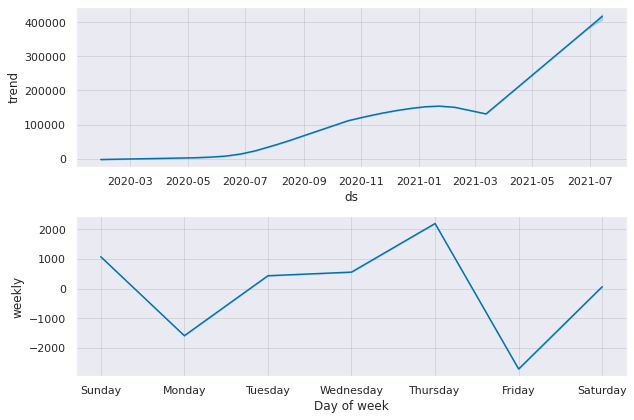

In [ ]:
Cured_plot2=model.plot_components(prediction)

In [ ]:
from fbprophet.diagnostics import cross_validation
confirmed_cv = cross_validation(model, horizon = '20 days')
confirmed_cv.head()

INFO:fbprophet:Making 44 forecasts with cutoffs between 2020-03-31 00:00:00 and 2021-06-04 00:00:00


,ds,yhat,yhat_lower,yhat_upper,y,cutoff
0,2020-04-01,70.728578,49.847310,91.435548,144,2020-03-31
1,2020-04-02,74.367026,53.901695,97.080973,156,2020-03-31
2,2020-04-03,79.162489,56.898437,100.563935,163,2020-03-31
3,2020-04-04,83.402333,61.437666,104.614876,213,2020-03-31
4,2020-04-05,87.642044,65.282535,111.504855,275,2020-03-31


In [ ]:
from fbprophet.diagnostics import performance_metrics
confirmed_p = performance_metrics(confirmed_cv)
confirmed_p.head()


,horizon,mse,rmse,mae,mape,mdape,coverage
0,2 days,2.280725e+12,1.510207e+06,625605.645502,0.108610,0.056931,0.045455
1,3 days,2.493128e+12,1.578964e+06,663615.522077,0.118541,0.062924,0.045455
2,4 days,2.726331e+12,1.651161e+06,703096.773769,0.128670,0.070219,0.045455
3,5 days,2.973255e+12,1.724313e+06,743410.177487,0.138835,0.078335,0.045455
4,6 days,3.219369e+12,1.794260e+06,782929.740463,0.147652,0.083532,0.045455


In [ ]:
confirmed_p.to_csv('CovidConfirmed_p.csv',index= False)

In [ ]:
confirmed_p.head()

,horizon,mse,rmse,mae,mape,mdape,coverage
0,2 days,2.280725e+12,1.510207e+06,625605.645502,0.108610,0.056931,0.045455
1,3 days,2.493128e+12,1.578964e+06,663615.522077,0.118541,0.062924,0.045455
2,4 days,2.726331e+12,1.651161e+06,703096.773769,0.128670,0.070219,0.045455
3,5 days,2.973255e+12,1.724313e+06,743410.177487,0.138835,0.078335,0.045455
4,6 days,3.219369e+12,1.794260e+06,782929.740463,0.147652,0.083532,0.045455


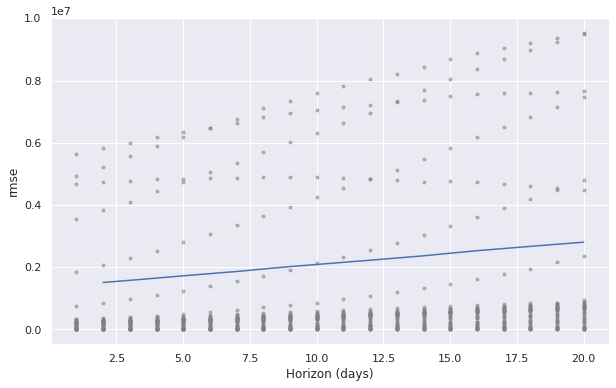

In [ ]:
from fbprophet.plot import plot_cross_validation_metric
fig = plot_cross_validation_metric(confirmed_cv, metric='rmse')